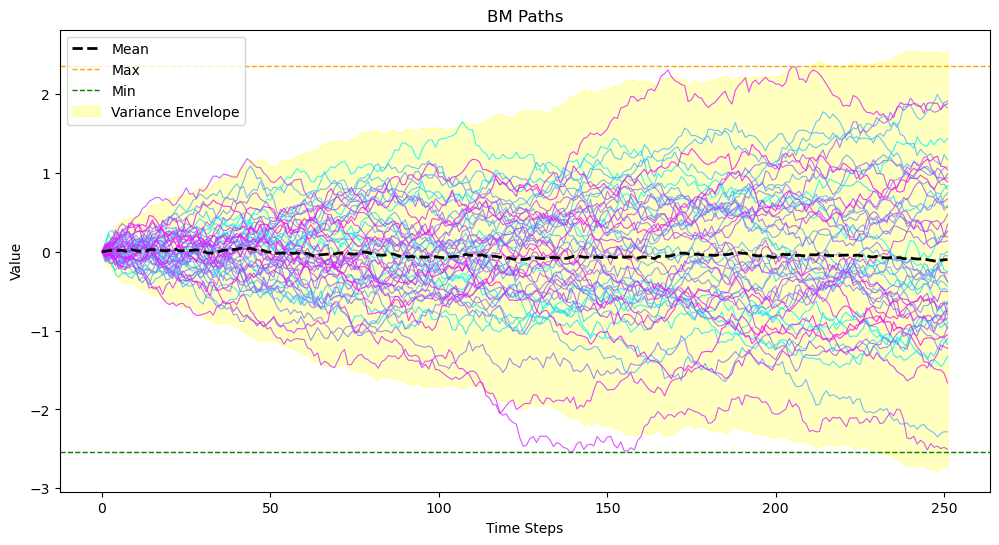

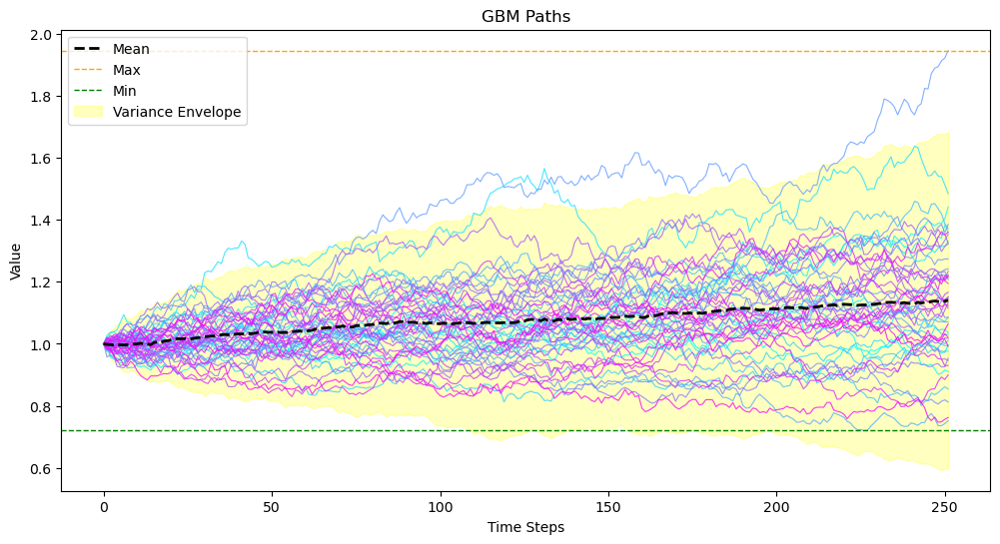

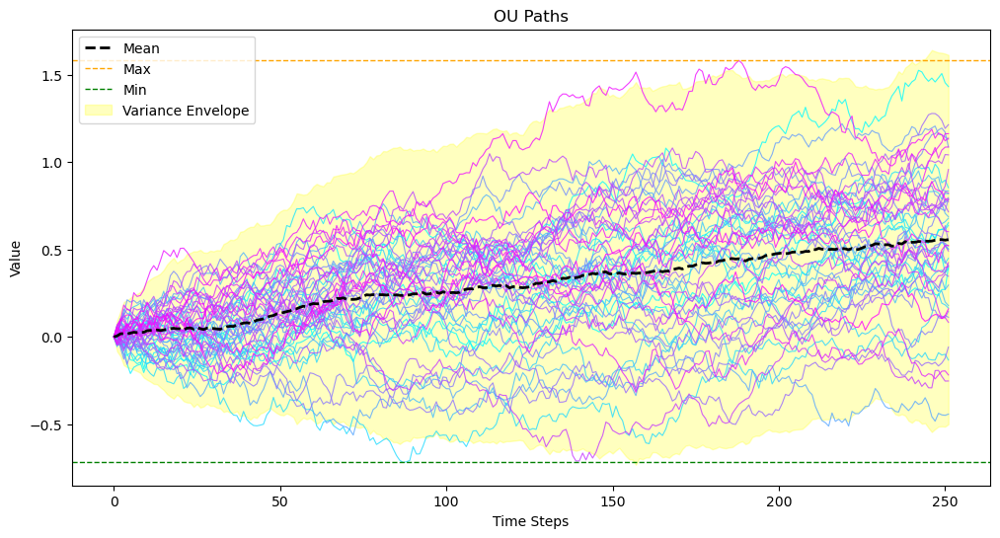

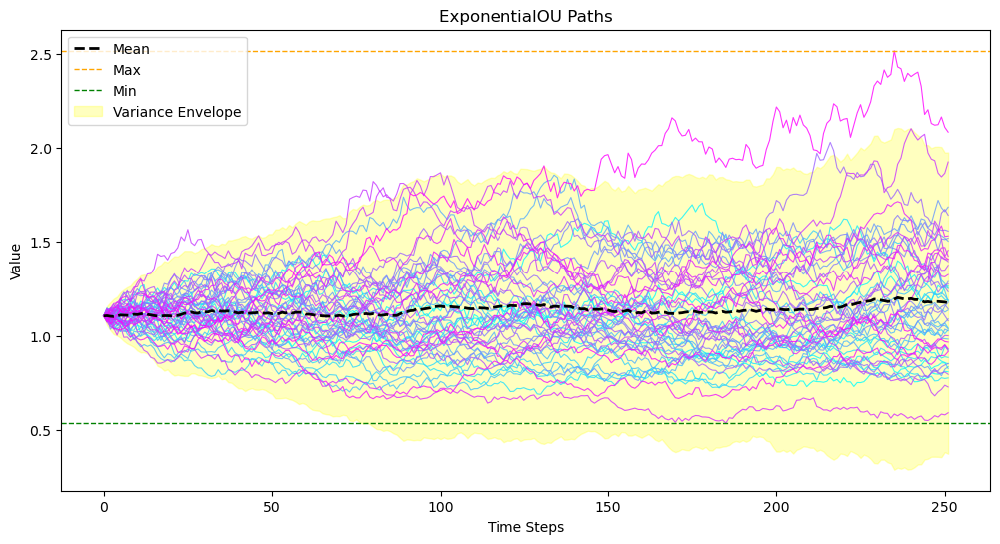

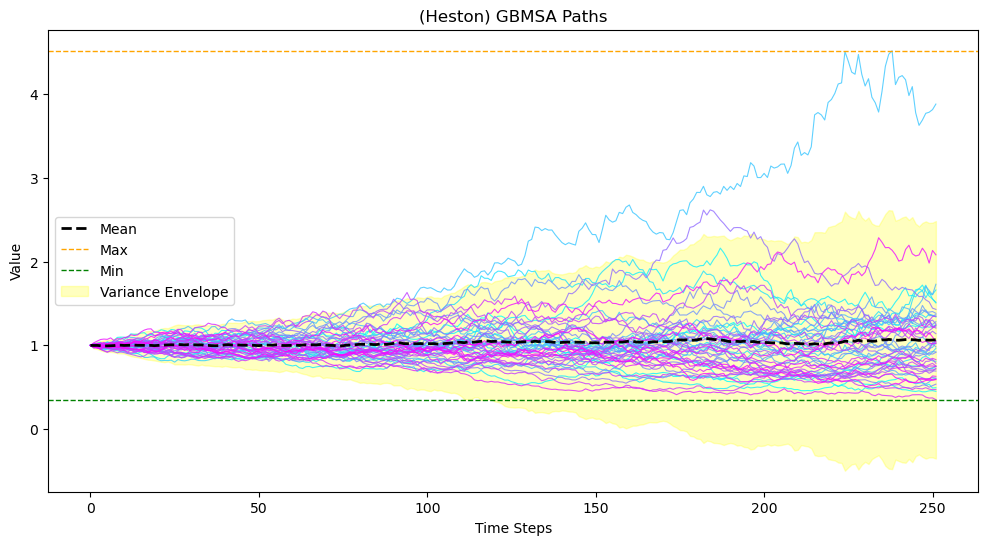

...

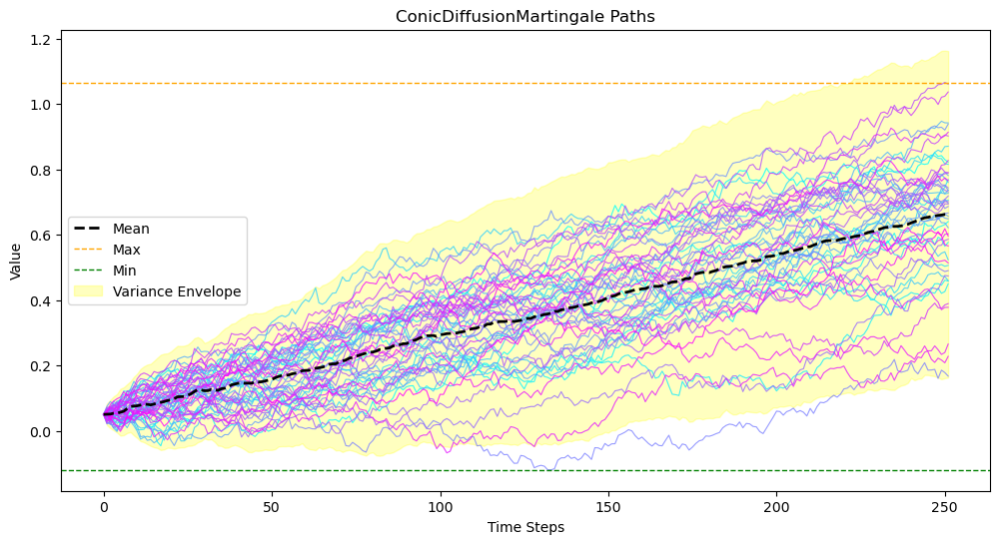

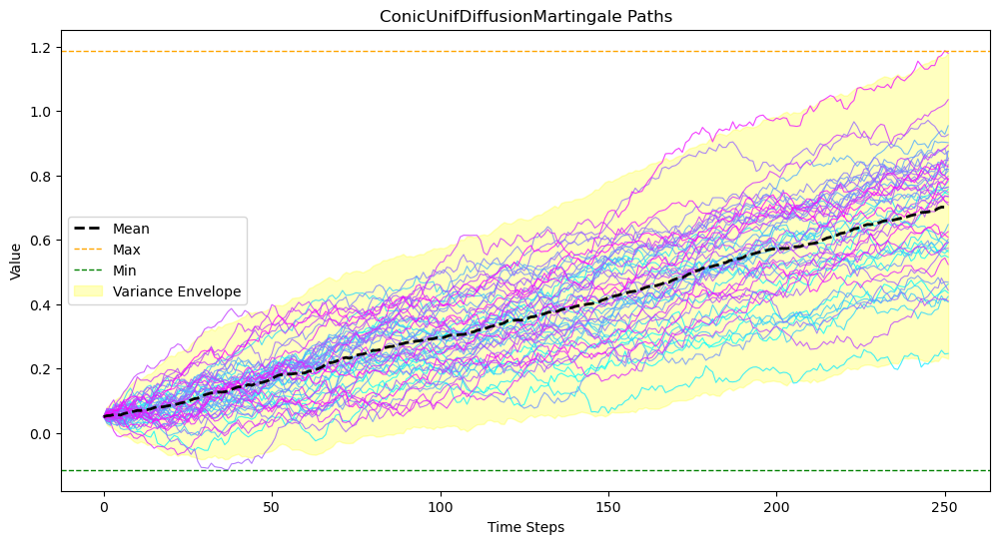

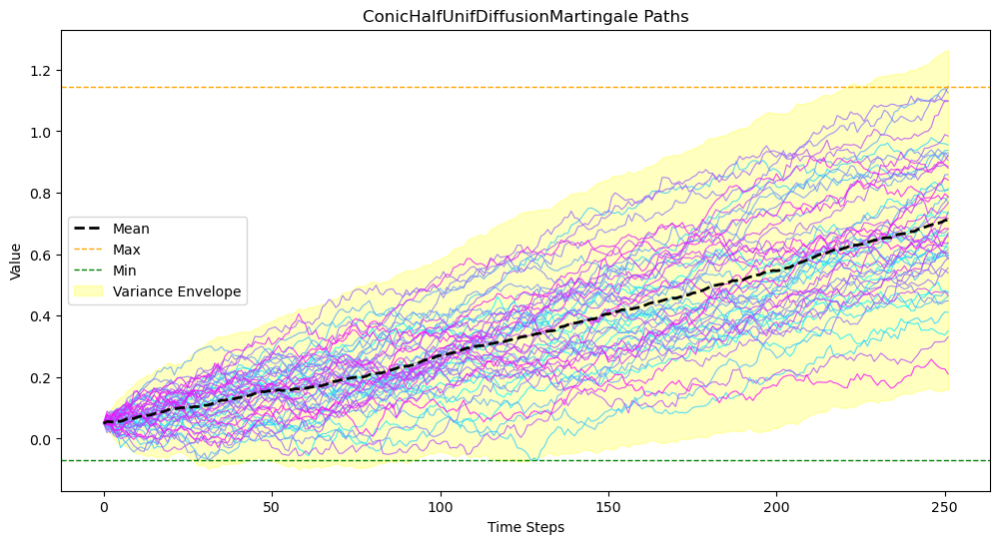

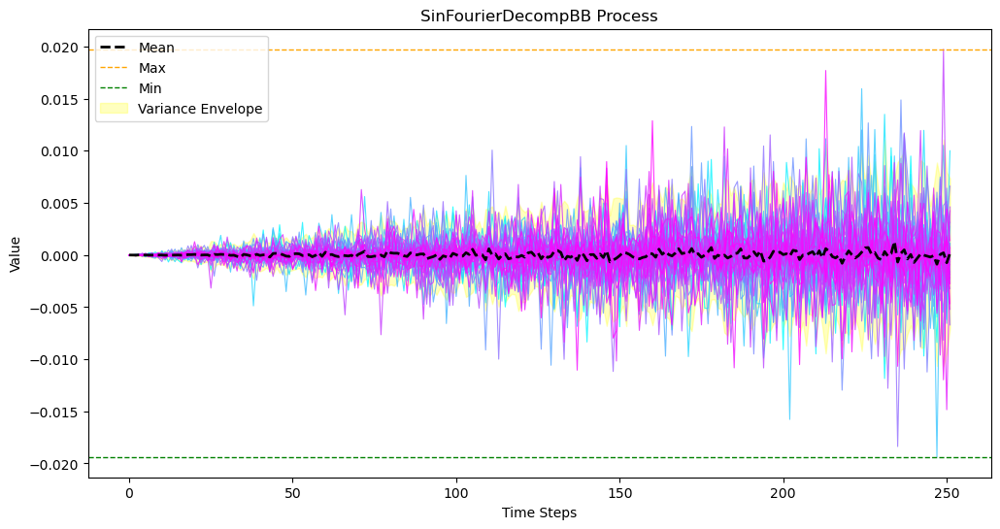

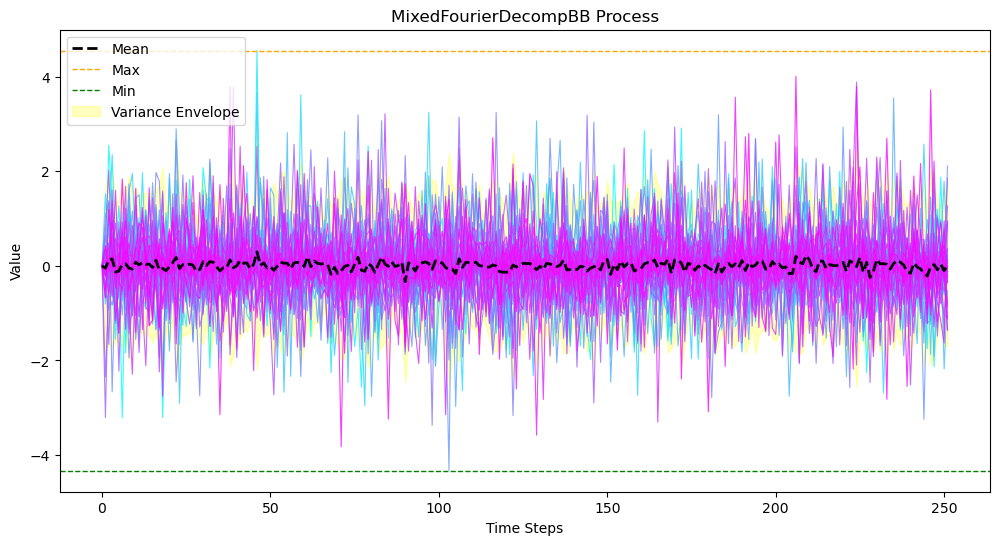

                             Process  Time (s)
0                                 BM  0.002444
1                                GBM  0.004023
2                                 OU  0.003220
3                      ExponentialOU  0.003544
4                     (Heston) GBMSA  0.012594
5                              srGBM  0.004012
6                                SBM  0.002644
7                     BrownianBridge  0.003163
8                    BrownianMeander  0.004487
9                  BrownianExcursion  0.003542
10                           DysonBM  0.004814
11                          StickyBM  0.003461
12                      ReflectingBM  0.003875
13                      CorrelatedBM  0.003887
14                     CorrelatedGBM  0.005458
15                          CircleBM  0.005878
16                    dDimensionalBM  0.004814
17                             3dGBM  0.006862
18                              3dOU  0.005572
19          StochasticLogisticGrowth  0.003742
20        Sto

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
from StochasticProcessSimulator import StochasticProcessSimulator

# List of process types
processes = [
    'BM', 'GBM', 'OU', 'ExponentialOU', '(Heston) GBMSA', 'srGBM', 'SBM', 'BrownianBridge', 'BrownianMeander',
     'BrownianExcursion', 'DysonBM', 'StickyBM', 'ReflectingBM', 'CorrelatedBM', 
     'CorrelatedGBM', 'CircleBM', 'dDimensionalBM', '3dGBM', '3dOU', 
     'StochasticLogisticGrowth', 'StochasticExponentialDecay', 'SinCosVectorNoiseIto',
     'PolynomialItoProcess', 'WrightFisherDiffusion', 'WeibullDiffusion', 'WeibullDiffusion2', 
     'ExpTC', 'MRSqrtDiff',

     'VG', 'VGSA', 'Merton', 'ATSM', 'ATSM_SV', 'CEV', 'CIR', 'Vasicek', 'ExponentialVasicek', 'SABR', 'ShiftedSABR',  
     'DTDG', 'CKLS', 'HullWhite', 'LotkaVolterra', 'TwoFactorHullWhite', 'BlackKarasinski', 'Chen', 
     'LongstaffSchwartz', 'BDT', 'HoLee', 'CIR++', 'CIR2++', 'KWF', 

     'Bates','GeneralBergomi', 'OneFactorBergomi', 'RoughBergomi', 'RoughVolatility',
     'RfSV', 'SinRFSV', 'TanhRFSV', 'ARIMA', 'GARCH', 'GARCHJump', 'VIX', 'GaussTanhPolyRFSV', 'LaplaceTanhPolyRFSV', 
      't_TanhPolyRFSV', 'CauchyTanhPolyRFSV', 'triangularTanhPolyRFSV', 'GumbelTanhPolyRFSV', 'LogisticTanhPolyRFSV',

     'SCP_mean_reverting', 'SCP_modified_OU', 'SCP_tanh_Ito', 'SCP_arctan_Ito', 'SCQuanto', 'WrightFisherSC', 'Jacobi',

     'fBM', 'GFBM', 'fOU', 'fIM', 'tanh_fOU', 'Poly_fOU', 'fStochasticLogisticGrowth', 
     'fStochasticExponentialDecay', 'fBM_WrightFisherDiffusion', 'fSV', 'Bessel', 'SquaredBessel', 
     'ConicDiffusionMartingale', 'ConicUnifDiffusionMartingale', 
     'ConicHalfUnifDiffusionMartingale', 'SinFourierDecompBB', 'MixedFourierDecompBB'
] 

# 'kCorrelatedGBMs', 'kCorrelatedBMs', 

# Simulation parameters
num_paths = 50
path_length = 252  # 1 year(s) with 252 trading days per year
dt = 1 / 252

# Initialize a dataframe to store execution times
execution_times = pd.DataFrame(columns=['Process', 'Time (s)'])

# Function to plot 2D paths with a colormap
def plot_paths(paths, title, plot_variance=False, envelope_width_multiple_of_sd = 5.2):
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap('cool')
    colors = cmap(np.linspace(0, 1, paths.shape[0]))
    for i in range(paths.shape[0]):
        plt.plot(paths[i], color=colors[i], alpha=0.8, linewidth=0.8)
    mean_path = np.mean(paths, axis=0)
    plt.plot(mean_path, color='black', linestyle='--', linewidth=2, label='Mean')
    plt.axhline(np.max(paths), color='orange', linestyle='--', linewidth=1, label='Max')
    plt.axhline(np.min(paths), color='green', linestyle='--', linewidth=1, label='Min')
    if plot_variance and paths.ndim == 2:
        variance = np.var(paths, axis=0)
        plt.fill_between(np.arange(len(mean_path)), mean_path - (envelope_width_multiple_of_sd/2)*np.sqrt(variance), mean_path + (envelope_width_multiple_of_sd/2)*np.sqrt(variance), color='yellow', alpha=0.25, label='Variance Envelope')
    plt.title(title)
    plt.xlabel('Time Steps')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

# Function to plot complex paths
def plot_complex_paths(paths, title):
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap('magma')
    colors = cmap(np.linspace(0, 1, paths[0].shape[0]))
    for i in range(paths[0].shape[0]):
        plt.plot(paths[0][i], paths[1][i], color=colors[i], alpha=0.8, linewidth=0.8)
    plt.title(title)
    plt.xlabel('Y_t')
    plt.ylabel('X_t')
    plt.show()

# Function to plot correlated 2D paths with different colormaps
def plot_correlated_paths(paths, title):
    plt.figure(figsize=(12, 6))
    for i in range(paths.shape[0]):
        plt.plot(paths[i, :, 0], color='cyan', alpha=0.8, linewidth=0.8)
        plt.plot(paths[i, :, 1], color='yellow', alpha=0.8, linewidth=0.8)
    mean_path1 = np.mean(paths[:, :, 0], axis=0)
    mean_path2 = np.mean(paths[:, :, 1], axis=0)
    plt.plot(mean_path1, color='black', linestyle='--', linewidth=2, label='Mean Path 1')
    plt.plot(mean_path2, color='blue', linestyle='--', linewidth=2, label='Mean Path 2')
    plt.axhline(np.max(paths[:, :, 0]), color='red', linestyle='--', linewidth=1, label='Max Path 1')
    plt.axhline(np.min(paths[:, :, 0]), color='green', linestyle='--', linewidth=1, label='Min Path 1')
    plt.axhline(np.max(paths[:, :, 1]), color='orange', linestyle='--', linewidth=1, label='Max Path 2')
    plt.axhline(np.min(paths[:, :, 1]), color='purple', linestyle='--', linewidth=1, label='Min Path 2')
    plt.title(title)
    plt.xlabel('Time Steps')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

# Function to plot 3D paths with a colormap
def plot_3d_paths(paths, title):
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    cmap = plt.get_cmap('magma')
    colors = cmap(np.linspace(0, 1, paths.shape[0]))
    for i in range(paths.shape[0]):
        ax.plot(paths[i, :, 0], paths[i, :, 1], paths[i, :, 2], color=colors[i], alpha=0.8, linewidth=0.8)
    ax.set_title(title)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.show()

def plot_eigenvalues(eigenvalues, title):
    plt.figure(figsize=(12, 6))
    for i in range(eigenvalues.shape[0]):
        plt.plot(eigenvalues[i], alpha=0.8, linewidth=0.8)
    plt.title(title)
    plt.xlabel('Time Steps')
    plt.ylabel('Eigenvalue')
    plt.show()

def plot_bessel_paths(paths, title, plot_variance=False, envelope_width_multiple_of_sd = 5):
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap('cool')
    colors = cmap(np.linspace(0, 1, paths.shape[0]))
    for i in range(paths.shape[0]):
        plt.plot(paths[i], color=colors[i], alpha=0.8, linewidth=0.8)
    mean_path = np.mean(paths, axis=0)
    upper_lim = np.mean(mean_path) + 3 * np.std(paths)
    lower_lim = np.mean(mean_path) - 3 * np.std(paths)
    plt.plot(mean_path, color='black', linestyle='--', linewidth=2, label='Mean')
    if plot_variance and paths.ndim == 2:
        variance = np.var(paths, axis=0)
        plt.fill_between(np.arange(len(mean_path)), mean_path - (envelope_width_multiple_of_sd/2)*np.sqrt(variance), mean_path + (envelope_width_multiple_of_sd/2)*np.sqrt(variance), color='yellow', alpha=0.25, label='Variance Envelope')
    plt.axhline(np.max(paths), color='orange', linestyle='--', linewidth=1, label='Max')
    plt.axhline(np.min(paths), color='green', linestyle='--', linewidth=1, label='Min')
    plt.ylim(lower_lim, upper_lim)
    plt.title(title)
    plt.title(title)
    plt.xlabel('Time Steps')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

def custom_a(t, X_t):
    return 0.05*X_t * X_t * np.sin(t) 

def custom_b(t, X_t):
    return 0.05*(-X_t*X_t*X_t) * np.cos(t) 

# Loop through each process type
for process in processes:
    start_time = time.time()

    # Set specific parameters for different processes
    if process == 'OU':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            kappa=0.5, theta=1.3, sigma=0.55, X0=0.0
        )
    elif process == 'CIR':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            kappa=0.55, theta=0.34, sigma=0.3, X0=0.04
        )
    elif process == 'GBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            mu=0.1, sigma=0.2, S0=1.0
        )
    elif process == '(Heston) GBMSA':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            mu=0.1, sigma=0.2, S0=1.0, kappa=1.0, theta=0.4, rho=0.3, v0=0.04
        )
    elif process == 'VG':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            sigma=0.2, theta=0.1, nu=0.1, S0=1.0
        )
    elif process == 'VGSA':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            sigma=0.2, theta=0.4, nu=0.1, S0=1.0, kappa=0.5, eta=0.1, lambda_=0.1, v0=0.1
        )
    elif process == 'Merton':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            mu=-0.3, sigma=0.2, S0=1.0, lambda_=0.1, muJ=0.9, sigmaJ=0.15
        )
    elif process == 'ATSM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            ar=0.01, br=np.array([0.02]), B=np.array([[0.03]]), Sigma=np.array([[0.1]]), x0=np.array([0.0])
        )
    elif process == 'ATSM_SV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            ar=0.01, br=np.array([0.02]), B=np.array([[0.03]]), Sigma=np.array([[0.1]]), x0=np.array([0.0]), 
            kappa=0.74, theta=0.7, lambda_=0.9, v0=0.7
        )
    elif process == 'CEV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            mu=0.3, sigma=0.2, S0=1.0, beta=0.5
        )
    elif process == 'BrownianBridge':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            X0=0.0, XT=0.9
        )
    elif process == 'BrownianMeander':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            X0=0.0
        )
    elif process == 'BrownianExcursion':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            X0=0.0
        )
    elif process == 'CorrelatedBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            rho=0.5
        )
    elif process == 'CorrelatedGBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            mu1=0.3, sigma1=0.05, S01=1.0, mu2=-0.3, sigma2=0.05, S02=1.0, rho=-0.6
        )
    elif process == 'dDimensionalBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            d=3
        )
    elif process == '3dGBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            mu=np.array([0.3, 0.3, 0.3]), sigma=np.eye(3) * 0.2, S0=np.array([1.0, 1.0, 1.0])
        )
    elif  process == '3dOU': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            kappa=0.9, theta=np.array([1.0, 1.0, 1.0]), sigma=np.eye(3), X0=np.zeros(3)
        )
    elif process == 'Vasicek':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            a=0.55, b=-0.9, sigma=0.035, r0=0.15
        )
    elif process == 'DysonBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            n=1, epsilon=0.01  # Small offset to avoid division by zero
        )
    elif process == 'fBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            H=0.78, sigma=0.55
        )
    elif process == 'fIM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            H=0.78, sigma=0.15
        )
    elif process == 'SABR':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            alpha=0.3, beta=0.5, rho=-0.4, F0=0.4, sigma0=0.2
        )
    elif process == 'ShiftedSABR':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            alpha=0.3, beta=0.5, rho=-0.4, F0=0.4, sigma0=0.2, s=0.47
        )
    elif process == 'BM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0=0.0, mu=0.0, sigma=1.0
        )
    elif process == 'StickyBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            mu=0.05, sticky_point=0.0, X0=0.0, sigma=0.5
        )
    elif process == 'ReflectingBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            lower_b=-1.0, upper_b=1.0, X0=0.0, sigma=1.0
        )
    elif process == 'DTDG': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            ar=0.01, br=0.02, B=np.array([[0.03]]), Sigma=0.5, x0 = np.array([0]), gamma = 0.5, lambda_ = 0.2, v0 = 0.1
        )
    elif process == 'CKLS': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            alpha=0.35, beta=0.55, gamma=0.5, sigma=0.05, X0 = 0
        )
    elif process == 'HullWhite': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            theta=lambda t: 0.05, alpha=lambda t: 0.09, sigma=lambda t: 0.01, r0 = 0.03
        )
    elif process == 'LotkaVolterra': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            a=0.35, b=0.1, sigma=0.45, X0 = 0.5
        )
    elif process == 'TwoFactorHullWhite':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            theta=lambda t: 0.05, alpha=lambda t: 0.09, sigma1=lambda t: 0.03, sigma2=0.09, b=0.03, r0=0.03, u0=0.3
        )
    elif process == 'BlackKarasinski':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            theta=lambda t: 0.05, phi=lambda t: 0.09, sigma=lambda t: 0.03, r0=0.03
        )
    elif process == 'Bates':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            gamma=0.05, q=0.02, sigma=0.2, mu=0.1, k=0.3, theta=0.04, sigma_v=0.02, lambda_=0.1, muJ=0.35, sigmaJ=0.1, S0=1.0
        )
    elif process == 'ExponentialVasicek':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            a=0.1, b=0.05, sigma=0.01, r0=0.03, rho=0.1, lambda_=0.1
        )
    elif process == 'GeneralBergomi':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            r=0.05, q=0.02, xi=0.1, omega=0.2
        )
    elif process == 'OneFactorBergomi':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            omega=0.2, kappa=0.3, XT=0.1, X0=0.05
        )
    elif process == 'RoughBergomi':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            eta=0.3, nu=0.5, rho=0.1, xi0=0.1
        )
    elif process == 'RoughVolatility':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            B=lambda t: 0.1, xi=0.1, g=lambda t: 0.35
        )
    elif process == 'fSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            sigma_star=0.15, gamma_h=0.59, sigma_h_star=0.35, y0=0.5, h0=0.95, H=0.83, sigma=0.2
        )
    elif process == 'fOU':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=0.8, kappa=8.1, m=0.05, X0=0.05, H=0.3, sigma=0.2
        )
    elif process == 'RfSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=0.5, H=0.15, sigma=0.2, sigma0=0.2
        )
    elif process == 'Bessel':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            n=2, X0=0.05
        )
    elif process == 'SquaredBessel':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            delta=2, X0=0.05
        )
    elif process == 'GARCH':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            kappa=1.0, theta=0.35, sigma=0.2, lambda0=0.15
        )
    elif process == 'GARCHJump':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            beta0=0.9, beta1=0.5, beta2=0.35, c=0.25, lambda_=0.1, muJ=-0.015, sigmaJ=0.1
        )
    elif process == 'VIX':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            v0=0.15, nu=0.5, rho=-0.7, H=0.35, xi=0.1
        )
    elif process == 'GFBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            H=0.9, sigma=2, theta=0.78, X0=0.03
        )
    elif process == 'StochasticLogisticGrowth':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            r=3.0, K=1.5, sigma=0.2, X0=0.1
        )
    elif process == 'StochasticExponentialDecay':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            sigma=0.2, X0=1.0
        )
    elif process == 'SinCosVectorNoiseIto':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            X0=0.05, sigma=0.1, A=3, B=1
        )
    elif process == 'ExponentialOU':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            theta=0.7, mu=0.15, sigma=0.35, X0=0.1
        )
    elif process == 'SCP_mean_reverting':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            kappa=1.9, mu=0.5, sigma=0.2, X0=0.05
        )
    elif process == 'SCP_modified_OU':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            kappa=3.3, mu=0.5, sigma=0.2, X0=0.05
        )
    elif process == 'SCP_tanh_Ito':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            a=custom_a, b=custom_b, X0=0.1
        )
    elif process == 'SCP_arctan_Ito':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            a=custom_a, b=custom_b, X0=0.1
        )
    elif process == 'SCQuanto':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            muS=0.15, sigmaS=0.1, S0=1.0, muR=0.13, sigmaR=0.8, R0=1.0, 
            kappa=0.75, mu=0.1, sigma=0.1, rho0=0.25
        )
    elif process == 'Chen':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            kappa=0.5, theta0=0.1, sigma0=0.1, r0=0.03, 
            nu=0.1, zeta=0.1, alpha=0.1, mu=0.1, beta=0.1, eta=0.1
        )
    elif process == 'LongstaffSchwartz':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            a_t=lambda t: 0.1, c_t=lambda t: 0.1, d_t=lambda t: 0.1, f_t=lambda t: 0.1, 
            b=0.1, e=0.1, theta=0.1, mew=0.1
        )
    elif process == 'BDT':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            theta_t=lambda t: np.sin(t), sigma_t=lambda t: 3*t*t+1, sigma_t_prime=lambda t: 6*t+1, r0=0.05
        )
    elif process == 'HoLee':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            theta_t=lambda t: np.sin(0.1*t), sigma=0.1, r0=0.03
        )
    elif process == 'CIR++':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            a=0.1, b=0.05, sigma=0.5, phi_t=lambda t: 0.1*np.sin(t), X0=0.00005
        )
    elif process == 'KWF':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            theta_t=lambda t: 0.1*t*t, sigma=0.1, r0=0.03
        )
    elif process == 'fStochasticLogisticGrowth':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            r=1.15, K=1.0, sigma=0.5, X0=0.05, H=0.3
        )
    elif process == 'fStochasticExponentialDecay':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            sigma=0.5, X0=1.0, H=0.3
        )
    elif process == 'tanh_fOU':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            nu=5.5, kappa=10.0, m=0.5, X0=0.05, H=0.85, sigma=0.15
        )
    elif process == 'ARIMA':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            p=2, d=1, q=1, ar_params=np.array([0.3]), ma_params=np.array([-0.5])
        )
    elif process == 'SinRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            nu=0.5, H=0.4, sigma=0.2, sigma0=0.2, A=1.0
        )
    elif process == 'TanhRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, 
            nu=0.5, H=0.4, sigma=0.2, sigma0=0.2, A=1.0
        )
    elif process == 'ConicDiffusionMartingale':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            b=lambda t: 0.5 * np.sin(t), b_prime=lambda t: 0.5 * np.cos(t), sigma=0.2, X0=0.05
        )
    elif process == 'ConicUnifDiffusionMartingale':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            b=lambda t: 0.5 * np.sin(t), b_prime=lambda t: 0.5 * np.cos(t), sigma=0.2, Z0=0.05
        )
    elif process == 'ConicHalfUnifDiffusionMartingale':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            b=lambda t: 0.5 * np.sin(t), b_prime=lambda t: 0.5 * np.cos(t), sigma=0.2, Y0=0.05
        )
    elif process == 'CircleBM':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt, c_x=1, c_y=5
        )
    elif process == 'SinFourierDecompBB':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            num_terms=100
        )
    elif process == 'MixedFourierDecompBB':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            num_terms=100
        )
    elif process == 'Jacobi': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            R_upper = 1.0, R_lower = -1.0, R = 0.005, k = 0.3, rho0 = 0.1, sigma = 2.0
        )
    elif process == 'WrightFisherDiffusion': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0 = 0.95, kappa = 0.7, rho_ = 0.7, sigma = 15.0
        )
    elif process == 'WrightFisherSC': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0 = 0.05, kappa = 1.3, rho_ = 0.1, sigma = 0.2
        )
    elif process == 'PolynomialItoProcess': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0 = 0.5, a = (lambda x: 0.05 * x * x + np.sin(x) - 0.1), b = (lambda x: 0.05 * (-x) + 0.15 * np.cos(x))
        )
    elif process == 'WeibullDiffusion': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0 = 0.05, k = 3, lambda_ = 10, alpha = 0.4
        )
    elif process == 'WeibullDiffusion2': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0 = 0.15, k = 3, lambda_ = 1, alpha = 2
        )
    elif process == 'kCorrelatedGBMs':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            mu=np.array([0.1, 0.2, 0.3]), sigma=np.eye(3) * 0.2, S0=np.ones(3), rho=np.array([[1, 0.5, 0.3], [0.5, 1, 0.2], [0.3, 0.2, 1]])
        )
    elif process == 'kCorrelatedBMs':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            mu=np.array([0.1, 0.2, 0.3]), sigma=np.eye(3), X0=np.zeros(3), rho=np.array([[1, 0.5, 0.3], [0.5, 1, 0.2], [0.3, 0.2, 1]])
        )
    elif process == 'Poly_fOU':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=0.09, kappa=0.07, m=0.15, sigma = 0.1, X0=0.05, H=0.15, coefficients=np.array([0.1, 0.15, -0.03, np.pi] + [0]*7)
        )
    elif process == 'GaussTanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.2, sigma0=0.2, scale_=0.1, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 'fBM_WrightFisherDiffusion':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            X0 = 0.95, kappa = 0.5, rho_ = 0.7, sigma_WFD = 2, sigma = 5, H = 0.8 
        )
    elif process == 'LaplaceTanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.2, sigma0=0.2, scale_=0.1, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 't_TanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.2, sigma0=0.2, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 'CauchyTanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.1, sigma0=0.1, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 'triagularTanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.2, sigma0=0.2, l=-1, r=1.5, m=0, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 'GumbelTanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.2, sigma0=0.2, scale_=0.1, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 'LogisticTanhPolyRFSV':
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            nu=5.0, H=0.8, sigma=0.2, sigma0=0.2, scale_=0.1, coefficients=np.array([0, -0.01, 0.2, -0.1] + [0]*7)
        )
    elif process == 'CIR2++': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            kappa_x=0.5, kappa_y=0.5, theta_x = 0.7, theta_y = 0.4, sigma_x = 0.2, sigma_y = 0.3, X0 = 1.1, Y0 = 1.05, phi_t = (lambda t: 0.030 * t * np.sin(t/100))
        )
    elif process == 'SBM': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            alpha=2, X0=0.5
        )
    elif process == 'ExpTC': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            sigma = 2, v = 3, X0 = 0.05, delta = 0.03 # delta cannot be 2, 3
        )
    elif process == 'srGBM': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            mu=0.5, sigma=0.5, S0 = 0.7, eta = 0.4, r = 2
        )
    elif process == 'MRSqrtDiff': 
        simulator = StochasticProcessSimulator(
            process_type=process, num_paths=num_paths, path_length=path_length, dt=dt,
            epsilon=1.9, kappa=0.8, theta = 0.7, X0 = 0.09
        )
    
    # Simulate paths
    paths = simulator.simulate()

    # Record execution time
    end_time = time.time()
    execution_times = pd.concat([execution_times, pd.DataFrame({'Process': [process], 'Time (s)': [end_time - start_time]})], ignore_index=True)

    # Plot paths and eigenvalues for DysonBM
    if process == 'DysonBM':
        num_paths, path_length, n = paths.shape
        eigenvalues = np.zeros((num_paths, path_length, n))
        for i in range(num_paths):
            for t in range(path_length):
                matrix = np.outer(paths[i, t, :], paths[i, t, :])
                eigvals = np.linalg.eigvalsh(matrix)
                eigenvalues[i, t, :] = np.sort(eigvals)
        plot_paths(paths[:, :, 0], f'{process} Process', plot_variance=True)  # Plot first component of DysonBM paths
        plot_eigenvalues(eigenvalues[:, :, 0], f'{process} Process Eigenvalues')  # Plot first eigenvalue of DysonBM paths

    elif process == 'CorrelatedBM' or process == 'CorrelatedGBM':
        plot_correlated_paths(paths, f'{process} Process')
    elif process == 'dDimensionalBM':
        plot_3d_paths(paths, '3D Brownian Motion')
    elif process == '3dOU': 
        plot_3d_paths(paths, '3d OU')
    elif process == '3dGBM': 
        plot_3d_paths(paths, '3d GBM') 
    elif process == 'Bessel':
        plot_bessel_paths(paths, 'Bessel Process', plot_variance=True)
    elif process == 'Bates':
        s_paths, vol_paths = paths
        plot_paths(s_paths, f'{process} S_t Paths', plot_variance=True)
        plot_paths(vol_paths, f'{process} sigma_t Paths', plot_variance=True)
    elif process == 'fSV':
        y_paths, h_paths = paths
        plot_paths(y_paths, f'{process} y_t Paths', plot_variance=True)
        plot_paths(h_paths, f'{process} h_t Paths', plot_variance=True)
    elif process == 'SCP_tanh_Ito': 
        X_paths, rho_paths = paths
        plot_paths(X_paths, f'{process} X_t Paths', plot_variance=True)
        plot_paths(rho_paths, f'{process} rho_t Paths', plot_variance=True)
    elif process == 'SCP_arctan_Ito': 
        X_paths, rho_paths = paths
        plot_paths(X_paths, f'{process} X_t Paths', plot_variance=True)
        plot_paths(rho_paths, f'{process} rho_t Paths', plot_variance=True)
    elif process == 'SCP_mean_reverting': 
        X_paths, rho_paths = paths
        plot_paths(X_paths, f'{process} X_t Paths', plot_variance=True)
        plot_paths(rho_paths, f'{process} rho_t Paths', plot_variance=True)
    elif process == 'SCP_modified_OU': 
        X_paths, rho_paths = paths
        plot_paths(X_paths, f'{process} X_t Paths', plot_variance=True)
        plot_paths(rho_paths, f'{process} rho_t Paths', plot_variance=True)
    elif process == 'SCQuanto': 
        S_paths, R_paths, rho_paths = paths
        plot_paths(S_paths, f'{process} S_t Paths', plot_variance=True)
        plot_paths(R_paths, f'{process} R_t Paths', plot_variance=True)
        plot_paths(rho_paths, f'{process} rho_t Paths', plot_variance=True)
    elif process == 'Chen':
        rt, theta_t, sigma_t = paths
        plot_paths(rt, f'{process} r_t Paths', plot_variance=True)
        plot_paths(theta_t, f'{process} theta_t Paths', plot_variance=True)
        plot_paths(sigma_t, f'{process} sigma_t Paths', plot_variance=True)
    elif process == 'LongstaffSchwartz':
        Xt, Yt, rt = paths
        plot_paths(Xt, f'{process} X_t Paths', plot_variance=True)
        plot_paths(Yt, f'{process} Y_t Paths', plot_variance=True)
        plot_paths(rt, f'{process} r_t Paths', plot_variance=True)
    elif process == 'BDT':
        rt = paths
        plot_paths(rt, f'{process} r_t Paths', plot_variance=True)
    elif process == 'HoLee':
        rt = paths
        plot_paths(rt, f'{process} r_t Paths', plot_variance=True)
    elif process == 'CIR++':
        rt = paths
        plot_paths(rt, f'{process} r_t Paths', plot_variance=True)
    elif process == 'KWF':
        rt = paths
        plot_paths(rt, f'{process} r_t Paths', plot_variance=True)
    elif process == 'CircleBM':
        plot_complex_paths(paths, 'CircleBM Process')
    elif process in ['SinFourierDecompBB', 'MixedFourierDecompBB']:
        plot_paths(paths, f'{process} Process', plot_variance=True)
    elif process == 'Poly_fOU':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 'GaussTanhPolyRFSV':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 'LaplaceTanhPolyRFSV':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 't_TanhPolyRFSV':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 'CauchyTanhPolyRFSV':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 'GumbelTanhPolyRFSV':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 'LogisticTanhPolyRFSV':
        plot_paths(paths, f'{process} Paths', plot_variance=True)
        plt.figure(figsize=(12, 6))
        t = np.linspace(0, path_length * dt, path_length)
        polynomial = np.zeros_like(t)
        for i, coef in enumerate(simulator.params['coefficients']):
            polynomial += coef * (t ** i)
        plt.plot(t, polynomial, label='Polynomial Transformation')
        plt.title(f'Polynomial Transformation for {process}')
        plt.xlabel('x')
        plt.ylabel('f(x)')
        plt.legend()
        plt.show()
    elif process == 'ExpTC':
        x_paths, y_paths, tau_paths = paths
        plot_paths(x_paths, f'{process} x_t Paths', plot_variance=True)
        plot_paths(y_paths, f'{process} y_t Paths', plot_variance=True)
        plot_paths(tau_paths, f'{process} tau_transformation_of_t Paths')
    elif process == 'CIR2++':
        x_paths, y_paths, r_paths, phi = paths
        plot_paths(x_paths, f'{process} x_t Paths', plot_variance=True)
        plot_paths(y_paths, f'{process} y_t Paths', plot_variance=True)
        plot_paths(r_paths, f'{process} r_t Paths', plot_variance=True)
        t = np.arange(path_length)
        phi_t = lambda t: 0.030 * t * np.sin(t/100)
        phi = np.array([phi_t(ti) for ti in t])
        plt.figure(figsize=(10, 6))
        plt.plot(t, phi, label='$\phi(t)$')
        plt.title('CIR2++ $\phi(t)$ as a function of t')
        plt.xlabel('Time Steps')
        plt.ylabel('$\phi(t)$')
        plt.legend()
        plt.grid(True)
        plt.show()

    else: 
        plot_paths(paths, f'{process} Paths', plot_variance=True)

pd.set_option('display.max_columns', None) #prevents trailing elipses
pd.set_option('display.max_rows', None)
# Display execution times
print(execution_times)

